In [7]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import os
import tensorflow as tf
import tensorflow.keras.layers as tfl

from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing import image_dataset_from_directory
from tensorflow.keras.layers.experimental.preprocessing import RandomFlip, RandomRotation

In [8]:
BATCH_SIZE = 32
IMG_SIZE = (299, 299)
directory = "../image_dataset/cropped/image"
train_dataset = image_dataset_from_directory(directory,
                                             shuffle=True,
                                             batch_size=BATCH_SIZE,
                                             image_size=IMG_SIZE,
                                             validation_split=0.2,
                                             subset='training',
                                             seed=42,
                                             label_mode = 'categorical')
validation_dataset = image_dataset_from_directory(directory,
                                             shuffle=True,
                                             batch_size=BATCH_SIZE,
                                             image_size=IMG_SIZE,
                                             validation_split=0.2,
                                             subset='validation',
                                             seed=42,
                                             label_mode = 'categorical')

Found 45198 files belonging to 5 classes.
Using 36159 files for training.
Found 45198 files belonging to 5 classes.
Using 9039 files for validation.


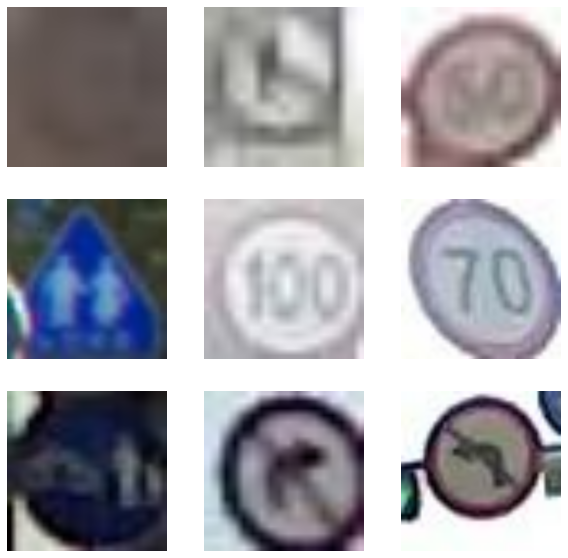

In [9]:
class_names = train_dataset.class_names

plt.figure(figsize=(10, 10))
for images, labels in train_dataset.take(1):
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.axis("off")

In [10]:
AUTOTUNE = tf.data.experimental.AUTOTUNE
train_dataset = train_dataset.prefetch(buffer_size=AUTOTUNE)

In [11]:
def data_augmenter():
    '''
    Create a Sequential model composed of 2 layers
    Returns:
        tf.keras.Sequential
    '''
    data_augmentation = tf.keras.Sequential([])
    #data_augmentation.add(RandomFlip('horizontal'))
    data_augmentation.add(RandomRotation(0.1))
    
    return data_augmentation

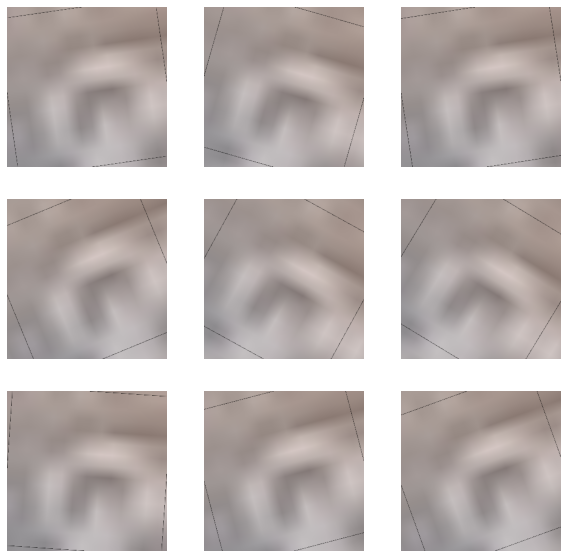

In [12]:
data_augmentation = data_augmenter()

for image, _ in train_dataset.take(1):
    plt.figure(figsize=(10, 10))
    first_image = image[0]
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        augmented_image = data_augmentation(tf.expand_dims(first_image, 0))
        plt.imshow(augmented_image[0] / 255)
        plt.axis('off')

In [13]:
preprocess_input = tf.keras.applications.inception_resnet_v2 .preprocess_input
IMG_SHAPE = IMG_SIZE + (3,)
base_model = tf.keras.applications.InceptionResNetV2(input_shape=IMG_SHAPE,
                                               include_top=True,
                                               weights='imagenet')

In [14]:
base_model.summary()

Model: "inception_resnet_v2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 299, 299, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 149, 149, 32) 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 149, 149, 32) 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, 149, 149, 32) 0           batch_normalization[0][0]        
________________________________________________________________________________

In [15]:
nb_layers = len(base_model.layers)
print(base_model.layers[nb_layers - 2].name)
print(base_model.layers[nb_layers - 1].name)

avg_pool
predictions


In [16]:
image_batch, label_batch = next(iter(train_dataset))
feature_batch = base_model(image_batch)
print(feature_batch.shape)

(32, 1000)


In [17]:
base_model.trainable = False
image_var = tf.Variable(preprocess_input(image_batch))
pred = base_model(image_var)

tf.keras.applications.mobilenet_v2.decode_predictions(pred.numpy(), top=2)

[[('n03196217', 'digital_clock', 0.4255879),
  ('n03197337', 'digital_watch', 0.04421244)],
 [('n01990800', 'isopod', 0.14475149),
  ('n02606052', 'rock_beauty', 0.10552745)],
 [('n04380533', 'table_lamp', 0.36447886),
  ('n03903868', 'pedestal', 0.14391963)],
 [('n03706229', 'magnetic_compass', 0.47921732),
  ('n02794156', 'barometer', 0.2870557)],
 [('n04591157', 'Windsor_tie', 0.06786652), ('n04612504', 'yawl', 0.0553012)],
 [('n02606052', 'rock_beauty', 0.5170525),
  ('n02108000', 'EntleBucher', 0.0228214)],
 [('n02865351', 'bolo_tie', 0.80043983),
  ('n03314780', 'face_powder', 0.016759034)],
 [('n04505470', 'typewriter_keyboard', 0.36920604),
  ('n03447721', 'gong', 0.07372127)],
 [('n03706229', 'magnetic_compass', 0.32554188),
  ('n03692522', 'loupe', 0.2315745)],
 [('n03706229', 'magnetic_compass', 0.53018993),
  ('n02794156', 'barometer', 0.27857843)],
 [('n04328186', 'stopwatch', 0.28035948),
  ('n02794156', 'barometer', 0.15928847)],
 [('n04612504', 'yawl', 0.19773033), ('n0

In [18]:
def traffic_sign_model(image_shape=IMG_SIZE, data_augmentation=data_augmenter()):
    ''' Define a tf.keras model for binary classification out of the MobileNetV2 model
    Arguments:
        image_shape -- Image width and height
        data_augmentation -- data augmentation function
    Returns:
    Returns:
        tf.keras.model
    '''
    
    
    input_shape = image_shape + (3,)
    
    base_model = tf.keras.applications.MobileNetV2(input_shape=input_shape,
                                                   include_top=False, # <== Important!!!!
                                                   weights='imagenet') # From imageNet
    
    # freeze the base model by making it non trainable
    base_model.trainable = False 

    # create the input layer (Same as the imageNetv2 input size)
    inputs = tf.keras.Input(shape=input_shape) 
    
    # apply data augmentation to the inputs
    #x = data_augmentation(inputs)
    
    # data preprocessing using the same weights the model was trained on
    x = preprocess_input(inputs) 
    
    # set training to False to avoid keeping track of statistics in the batch norm layer
    x = base_model(x, training=False) 
    
    # add the new Binary classification layers
    # use global avg pooling to summarize the info in each channel
    x = tfl.GlobalAveragePooling2D()(x) 
    # include dropout with probability of 0.2 to avoid overfitting
    x = tfl.Dropout(0.2)(x)
        
    # use a prediction layer with one neuron 
    outputs = tfl.Dense(5,activation='softmax')(x)
    
    
    model = tf.keras.Model(inputs, outputs)
    
    return model

In [19]:
model2 = traffic_sign_model(IMG_SIZE, data_augmentation)
model2.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model2.summary()

Model: "functional_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 299, 299, 3)]     0         
_________________________________________________________________
tf_op_layer_RealDiv (TensorF [(None, 299, 299, 3)]     0         
_________________________________________________________________
tf_op_layer_Sub (TensorFlowO [(None, 299, 299, 3)]     0         
_________________________________________________________________
mobilenetv2_1.00_224 (Functi (None, 10, 10, 1280)      2257984   
_________________________________________________________________
global_average_pooling2d (Gl (None, 1280)              0         
_________________________________________________________________
dropout (Dropout)            (None, 1280)              0         
_________________________________________________________________
dense (Dense)                (None, 5)                

In [20]:
initial_epochs = 5
history = model2.fit(train_dataset, validation_data=validation_dataset, epochs=initial_epochs)

Epoch 1/5
1130/1130 [==============================] - 969s 857ms/step - loss: 0.4767 - accuracy: 0.8233 - val_loss: 0.3193 - val_accuracy: 0.8908
Epoch 2/5
1130/1130 [==============================] - 956s 846ms/step - loss: 0.3317 - accuracy: 0.8803 - val_loss: 0.2820 - val_accuracy: 0.9030
Epoch 3/5
1130/1130 [==============================] - 954s 844ms/step - loss: 0.2999 - accuracy: 0.8920 - val_loss: 0.2721 - val_accuracy: 0.9070
Epoch 4/5
1130/1130 [==============================] - 977s 865ms/step - loss: 0.2900 - accuracy: 0.8944 - val_loss: 0.2498 - val_accuracy: 0.9172
Epoch 5/5
1130/1130 [==============================] - 1023s 905ms/step - loss: 0.2765 - accuracy: 0.8985 - val_loss: 0.2483 - val_accuracy: 0.9129


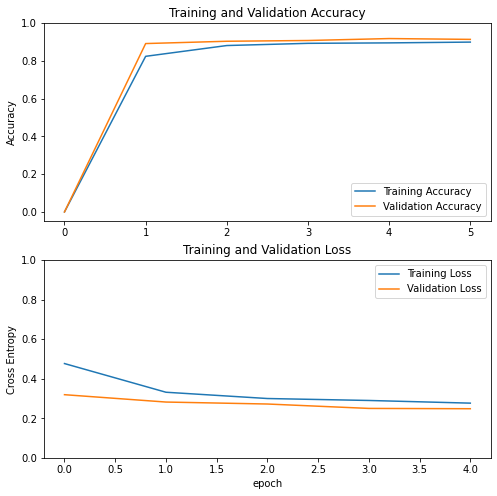

In [21]:
acc = [0.] + history.history['accuracy']
val_acc = [0.] + history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [26]:
model2.save('./inception_resnet_model')
model2.save_weights('./inception_resnet_weights')

Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
INFO:tensorflow:Assets written to: ./inception_resnet_model\assets


In [28]:
!pip install onnxruntime
!pip install git+https://github.com/onnx/tensorflow-onnx
!pip install tensorflow tf2onnx

  Cloning https://github.com/onnx/tensorflow-onnx to c:\users\user\appdata\local\temp\pip-req-build-0klie4ut
  Created wheel for tf2onnx: filename=tf2onnx-1.12.0-py3-none-any.whl size=445483 sha256=e9f6d053df06ecdc99c001b7f7c9c1d7bde8f475c5caada151d58e3c749e344e
  Stored in directory: C:\Users\User\AppData\Local\Temp\pip-ephem-wheel-cache-idtnwxg2\wheels\8d\c7\fe\7dc73855334ce8bd94435f3c357aeca17c69252864204cb133
Successfully built tf2onnx


In [29]:
import tf2onnx
import onnxruntime as rt

In [30]:
spec = (tf.TensorSpec((None, 299, 299, 3), tf.float32, name="input"),)
output_path = model2.name + ".onnx"

model_proto, _ = tf2onnx.convert.from_keras(model2, input_signature=spec, opset=13, output_path=output_path)
output_names = [n.name for n in model_proto.graph.output]

Instructions for updating:
Use `tf.compat.v1.graph_util.extract_sub_graph`


In [5]:
#providers = ['CPUExecutionProvider']
#m = rt.InferenceSession(output_path, providers=providers)
#onnx_pred = m.run(output_names, {"input": x})

#print('ONNX Predicted:', decode_predictions(onnx_pred[0], top=3)[0])

# make sure ONNX and keras have the same results
#np.testing.assert_allclose(preds, onnx_pred[0], rtol=1e-5)

NameError: name 'output_path' is not defined

In [37]:
#!python -m tf2onnx.convert --opset 13 \
#    --saved-model {os.path.join("/tmp", model2.name)} \
#    --output  {os.path.join("/tmp", model2.name + ".onnx")}

In [36]:
model2.save("savedmodel")
os.system("python -m tf2onnx.convert --saved-model savedmodel --output model.onnx --opset 13")

INFO:tensorflow:Assets written to: savedmodel\assets


0

In [38]:
import onnx
from onnx import shape_inference

In [40]:
onnx_path = "./model.onnx"
onnx_model = onnx.load(onnx_path)

graph = onnx_model.graph
initializers = dict()
for init in graph.initializer:
    initializers[init.name] = onnx.numpy_helper.to_array(init)

In [43]:
onnx_model

ir_version: 7
producer_name: "tf2onnx"
producer_version: "1.12.0 f4902a"
graph {
  node {
    input: "input_3"
    input: "ConstantFolding/StatefulPartitionedCall/functional_1/tf_op_layer_RealDiv/RealDiv_recip:0"
    output: "StatefulPartitionedCall/functional_1/tf_op_layer_RealDiv/RealDiv:0"
    name: "StatefulPartitionedCall/functional_1/tf_op_layer_RealDiv/RealDiv"
    op_type: "Mul"
  }
  node {
    input: "StatefulPartitionedCall/functional_1/tf_op_layer_RealDiv/RealDiv:0"
    input: "StatefulPartitionedCall/functional_1/tf_op_layer_Sub/Sub/y:0"
    output: "StatefulPartitionedCall/functional_1/tf_op_layer_Sub/Sub:0"
    name: "StatefulPartitionedCall/functional_1/tf_op_layer_Sub/Sub"
    op_type: "Sub"
  }
  node {
    input: "StatefulPartitionedCall/functional_1/tf_op_layer_Sub/Sub:0"
    output: "StatefulPartitionedCall/functional_1/mobilenetv2_1.00_224/Conv1/Conv2D__6:0"
    name: "StatefulPartitionedCall/functional_1/mobilenetv2_1.00_224/Conv1/Conv2D__6"
    op_type: "Transpo